In [25]:
import pandas as pd
import seaborn as sns
import plotly.express as px
import os
import numpy as np
import matplotlib.pyplot as plt

## Data analysis for Germany

In [26]:
# start by iterating and reading in all of the files
price_data = []
country = "Germany"
for i in [2015, 2016, 2017, 2018, "2018a", 2019, 2020, 2021, 2022]:
        price_data.append(pd.read_csv(os.path.join("Data", country,"Prices_{}".format(i))))

prices = pd.concat(price_data)

# general clean up
prices = prices.dropna(subset=["Day-ahead Price [EUR/MWh]"])
prices = prices[prices["Day-ahead Price [EUR/MWh]"] != "n/e"]
prices = prices[prices["Day-ahead Price [EUR/MWh]"] != "-"]
prices["Price"] = prices["Day-ahead Price [EUR/MWh]"].apply(float)
prices = prices[["MTU (CET/CEST)","Price"]]

# convert the time range into a start + end time
prices["Start"] = prices["MTU (CET/CEST)"].apply(lambda x: x.split("-")[0])
prices["End"] = prices["MTU (CET/CEST)"].apply(lambda x: x.split("-")[1])

In [27]:
# work through the same process for the load data
load_data = []
country = "Germany"
for i in [2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022]:
        df = pd.read_csv(os.path.join("Data", country,"Load_{}".format(i)))
        load_data.append(df)

loads = pd.concat(load_data)
loads["Forecast"] = loads["Day-ahead Total Load Forecast [MW] - BZN|DE-AT-LU"].combine_first(loads["Day-ahead Total Load Forecast [MW] - BZN|DE-LU"])
loads["Actual"] = loads["Actual Total Load [MW] - BZN|DE-AT-LU"].combine_first(loads["Actual Total Load [MW] - BZN|DE-LU"])
loads = loads.dropna(subset=["Forecast", "Actual"])
loads = loads[loads["Actual"] != "n/e"]
loads = loads[loads["Actual"] != "-"]
loads["Actual"] = loads["Actual"].apply(float)
loads["Forecast"] = loads["Forecast"].apply(float)

loads = loads[["Time (CET/CEST)", "Forecast", "Actual"]]
# make the time range effective
loads["Start"] = loads["Time (CET/CEST)"].apply(lambda x: x.split("-")[0])
loads["End"] = loads["Time (CET/CEST)"].apply(lambda x: x.split("-")[1])

In [28]:
#merge the two sets of data
merged = pd.merge(left = prices, right = loads, on = "Start", how="left")

merged.to_csv("./Germany_Elec")

### Plots

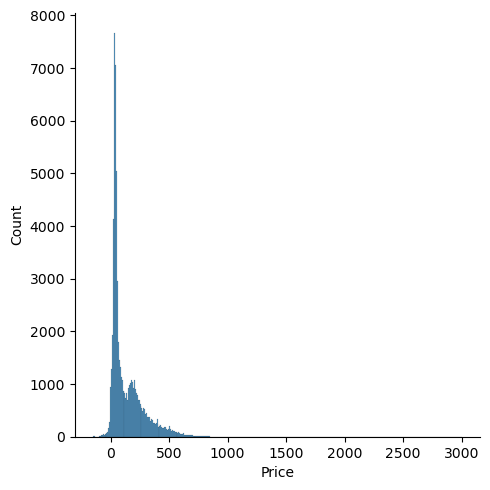

In [29]:
sns.displot(prices["Price"])

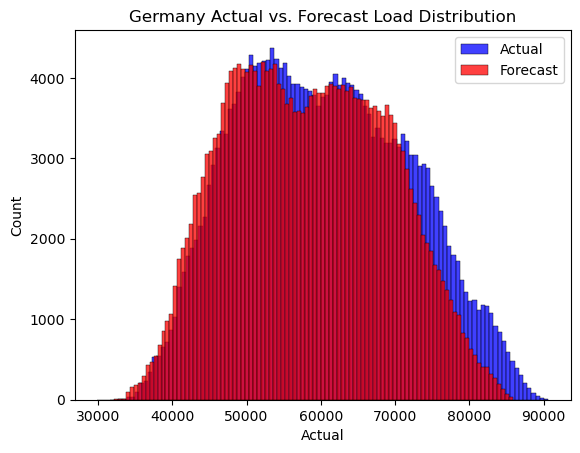

In [30]:
sns.histplot(loads, x="Actual", color="blue", kde = False, label = "Actual")
sns.histplot(loads, x="Forecast", color = "red", kde = False, label = "Forecast")

plt.title("Germany Actual vs. Forecast Load Distribution")
plt.legend()
plt.show()

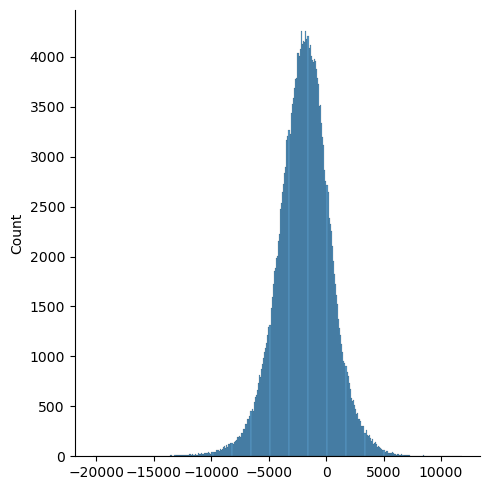

In [31]:
sns.displot(loads["Forecast"]-loads["Actual"])

In [32]:

# toss out the negative outliers
merged = merged[merged.Price > 0]
merged["Log Price"] = np.log(merged["Price"] + 1)
px.scatter(merged, x = "Forecast", y="Log Price", opacity = 0.1, trendline="ols", title = "Germany Historical Log Price vs. Forecast Load")


In [33]:
px.scatter(merged, x = "Forecast", y = "Price", opacity = 0.1, trendline="ols")

## Spain

In [34]:
price_data = []
country = "Spain"
for i in [2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022]:
        price_data.append(pd.read_csv(os.path.join("Data", country,"Prices_{}".format(i))))

prices = pd.concat(price_data)

# general clean up
prices = prices.dropna(subset=["Day-ahead Price [EUR/MWh]"])
prices = prices[prices["Day-ahead Price [EUR/MWh]"] != "n/e"]
prices = prices[prices["Day-ahead Price [EUR/MWh]"] != "-"]
prices["Price"] = prices["Day-ahead Price [EUR/MWh]"].apply(float)
prices = prices[["MTU (CET/CEST)","Price"]]

# convert the time range into a start + end time
prices["Start"] = prices["MTU (CET/CEST)"].apply(lambda x: x.split("-")[0])
prices["End"] = prices["MTU (CET/CEST)"].apply(lambda x: x.split("-")[1])


In [35]:
# work through the same process for the load data
load_data = []
country = "Spain"
for i in [2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022]:
        df = pd.read_csv(os.path.join("Data", country,"Load_{}".format(i)))
        load_data.append(df)

loads = pd.concat(load_data)
loads["Forecast"] = loads["Day-ahead Total Load Forecast [MW] - BZN|ES"].combine_first(loads["Day-ahead Total Load Forecast [MW] - BZN|ES"])
loads["Actual"] = loads["Actual Total Load [MW] - BZN|ES"].combine_first(loads["Actual Total Load [MW] - BZN|ES"])
loads = loads.dropna(subset=["Forecast", "Actual"])
loads = loads[loads["Actual"] != "n/e"]
loads = loads[loads["Actual"] != "-"]
loads["Actual"] = loads["Actual"].apply(float)
loads["Forecast"] = loads["Forecast"].apply(float)

loads = loads[["Time (CET/CEST)", "Forecast", "Actual"]]
# make the time range effective
loads["Start"] = loads["Time (CET/CEST)"].apply(lambda x: x.split("-")[0])
loads["End"] = loads["Time (CET/CEST)"].apply(lambda x: x.split("-")[1])

In [36]:
#merge the two sets of data
merged = pd.merge(left = prices, right = loads, on = "Start", how="left")
merged.to_csv("./Spain_Elec")

### Plots

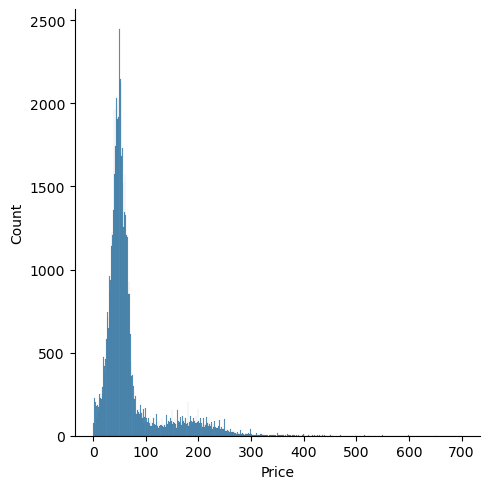

In [37]:
sns.displot(prices["Price"])

In [38]:
# toss out the negative outliers
# merged = merged[merged.Price > 0]
merged["Log Price"] = np.log(merged["Price"] + 1)
px.scatter(merged, x = "Forecast", y="Log Price", opacity = 0.1, trendline="ols", title = "Spain Historical Log Price vs. Forecast Load")

In [39]:
px.scatter(merged, x = "Forecast", y = "Price", opacity = 0.1, trendline="ols")

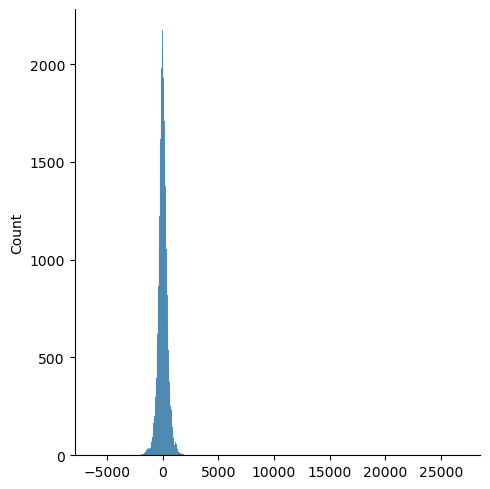

In [40]:
sns.displot(loads["Forecast"]-loads["Actual"])

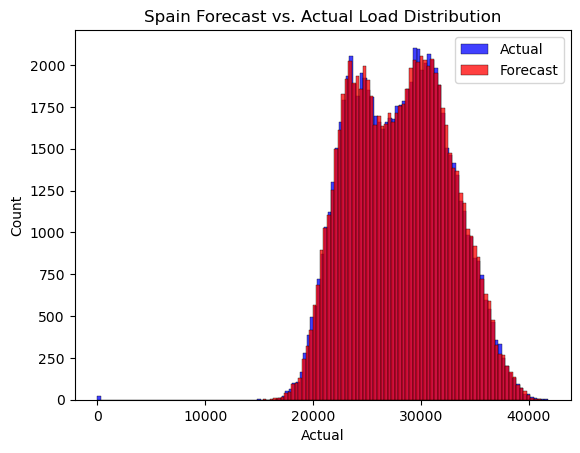

In [41]:
sns.histplot(loads, x="Actual", color="blue", kde = False, label = "Actual")
sns.histplot(loads, x="Forecast", color = "red", kde = False, label = "Forecast")

plt.title("Spain Forecast vs. Actual Load Distribution")
plt.legend()
plt.show()

## The Netherlands

In [42]:
price_data = []
country = "Netherlands"
for i in [2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022]:
        price_data.append(pd.read_csv(os.path.join("Data", country,"Prices_{}".format(i))))

prices = pd.concat(price_data)

# general clean up
prices = prices.dropna(subset=["Day-ahead Price [EUR/MWh]"])
prices = prices[prices["Day-ahead Price [EUR/MWh]"] != "n/e"]
prices = prices[prices["Day-ahead Price [EUR/MWh]"] != "-"]
prices["Price"] = prices["Day-ahead Price [EUR/MWh]"].apply(float)
prices = prices[["MTU (CET/CEST)","Price"]]

# convert the time range into a start + end time
prices["Start"] = prices["MTU (CET/CEST)"].apply(lambda x: x.split("-")[0])
prices["End"] = prices["MTU (CET/CEST)"].apply(lambda x: x.split("-")[1])


In [43]:
# work through the same process for the load data
load_data = []
country = "Netherlands"
for i in [2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022]:
        df = pd.read_csv(os.path.join("Data", country,"Load_{}".format(i)))
        load_data.append(df)

loads = pd.concat(load_data)
loads["Forecast"] = loads["Day-ahead Total Load Forecast [MW] - BZN|NL"].combine_first(loads["Day-ahead Total Load Forecast [MW] - BZN|NL"])
loads["Actual"] = loads["Actual Total Load [MW] - BZN|NL"].combine_first(loads["Actual Total Load [MW] - BZN|NL"])
loads = loads.dropna(subset=["Forecast", "Actual"])
loads = loads[loads["Actual"] != "n/e"]
loads = loads[loads["Actual"] != "-"]
loads["Actual"] = loads["Actual"].apply(float)
loads["Forecast"] = loads["Forecast"].apply(float)

loads = loads[["Time (CET/CEST)", "Forecast", "Actual"]]
# make the time range effective
loads["Start"] = loads["Time (CET/CEST)"].apply(lambda x: x.split("-")[0])
loads["End"] = loads["Time (CET/CEST)"].apply(lambda x: x.split("-")[1])

In [44]:
#merge the two sets of data
merged = pd.merge(left = prices, right = loads, on = "Start", how="left")
merged.to_csv("./Dutch_Elec")


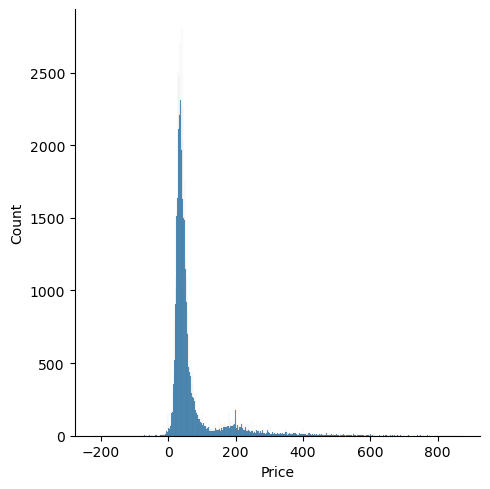

In [45]:
sns.displot(prices["Price"])

In [46]:
# toss out the negative outliers
merged = merged[merged.Price > 0]
merged["Log Price"] = np.log(merged["Price"] + 1)
px.scatter(merged, x = "Forecast", y="Log Price", opacity = 0.1, trendline="ols", title = "Netherlands Historical Log Price vs. Day Ahead Load")

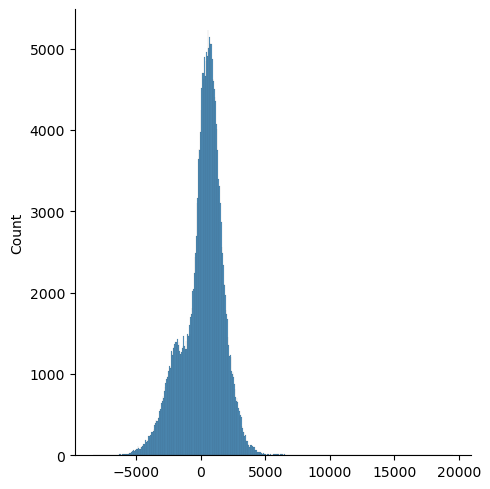

In [47]:
sns.displot(loads["Forecast"]-loads["Actual"])

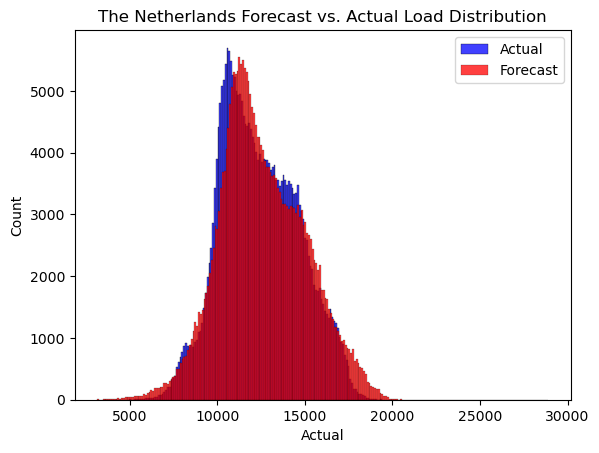

In [48]:
sns.histplot(loads, x="Actual", color="blue", kde = False, label = "Actual")
sns.histplot(loads, x="Forecast", color = "red", kde = False, label = "Forecast")

plt.title("The Netherlands Forecast vs. Actual Load Distribution")
plt.legend()
plt.show()